In [15]:
import os

# Path to the dataset folder
data_path = 'stock'

# List all files in the folder to confirm access
# files = os.listdir(data_path)
files = [f for f in os.listdir(data_path) if f.endswith('.csv')]
print("Files in dataset folder:", files)

Files in dataset folder: ['ADANIPORTS.csv', 'ASIANPAINT.csv', 'AXISBANK.csv', 'BAJAJ-AUTO.csv', 'BAJAJFINSV.csv', 'BAJFINANCE.csv', 'BHARTIARTL.csv', 'BPCL.csv', 'BRITANNIA.csv', 'CIPLA.csv', 'COALINDIA.csv', 'DRREDDY.csv', 'EICHERMOT.csv', 'GAIL.csv', 'GRASIM.csv', 'HCLTECH.csv', 'HDFC.csv', 'HDFCBANK.csv', 'HEROMOTOCO.csv', 'HINDALCO.csv', 'HINDUNILVR.csv', 'ICICIBANK.csv', 'INDUSINDBK.csv', 'INFRATEL.csv', 'INFY.csv', 'IOC.csv', 'ITC.csv', 'JSWSTEEL.csv', 'KOTAKBANK.csv', 'LT.csv', 'MARUTI.csv', 'MM.csv', 'NESTLEIND.csv', 'NIFTY50_all.csv', 'NTPC.csv', 'ONGC.csv', 'POWERGRID.csv', 'RELIANCE.csv', 'SBIN.csv', 'SHREECEM.csv', 'stock_metadata.csv', 'SUNPHARMA.csv', 'TATAMOTORS.csv', 'TATASTEEL.csv', 'TCS.csv', 'TECHM.csv', 'TITAN.csv', 'ULTRACEMCO.csv', 'UPL.csv', 'VEDL.csv', 'WIPRO.csv', 'ZEEL.csv']


In [16]:
import pandas as pd
import matplotlib.pyplot as plt


In [17]:
def process_and_plot(data_path, title_suffix):
    # Load the dataset
    df = pd.read_csv(data_path)

    # Check if 'Date' column exists before processing
    if 'Date' in df.columns:
        # Convert 'Date' column to datetime and set it as the index
        df['Date'] = pd.to_datetime(df['Date'])
        df.set_index('Date', inplace=True)

        # Sort data by date
        df.sort_index(inplace=True)

    # Check if 'Close' column exists, otherwise use a different column or skip
    if 'Close' in df.columns:
        plot_column = 'Close'  # Use 'Close' if it exists
    elif 'Closing Price' in df.columns:
        plot_column = 'Closing Price'  # Check for 'Closing Price' as alternative
    else:
        print(f"Skipping {data_path}: 'Close' or 'Closing Price' column not found.")
        return  # Skip plotting if neither column is found
    df['30_day_MA'] = df[plot_column].rolling(window=30).mean()
    df['100_day_MA'] = df[plot_column].rolling(window=100).mean()

    # Plotting for the current file
    # Pass the full file path to the functionany name from file name
    company_name = os.path.basename(data_path).split('.')[0]

    # Plot closing price over time
    plt.figure(figsize=(12, 6))
    plt.plot(df[plot_column], label='Close Price')
    plt.title(f'Stock Closing Price Over Time - {title_suffix}\n{company_name}') # Add company name to title
    plt.xlabel('Date' if 'Date' in df.columns else 'Index')
    plt.ylabel('Close Price')
    plt.legend()
    plt.grid(True)
    plt.show()

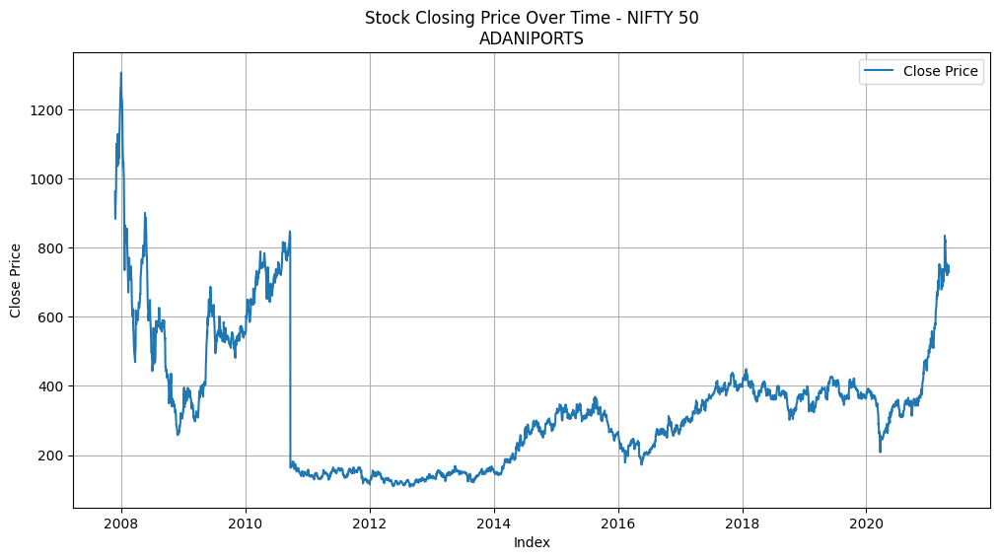

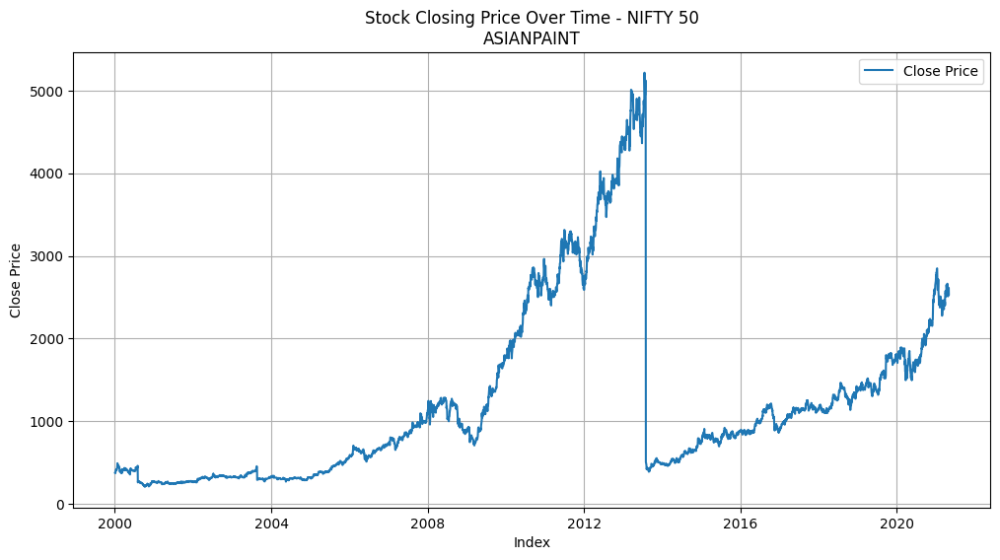

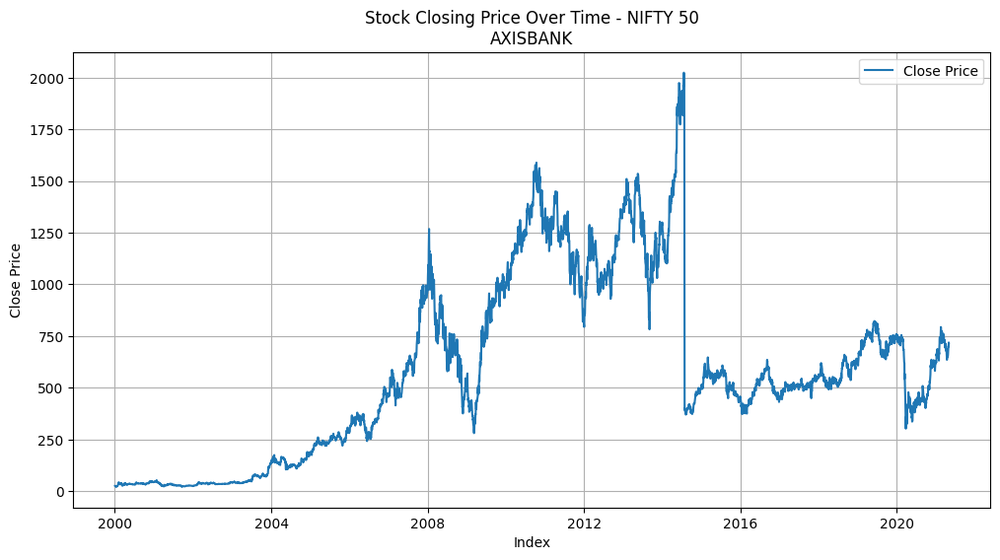

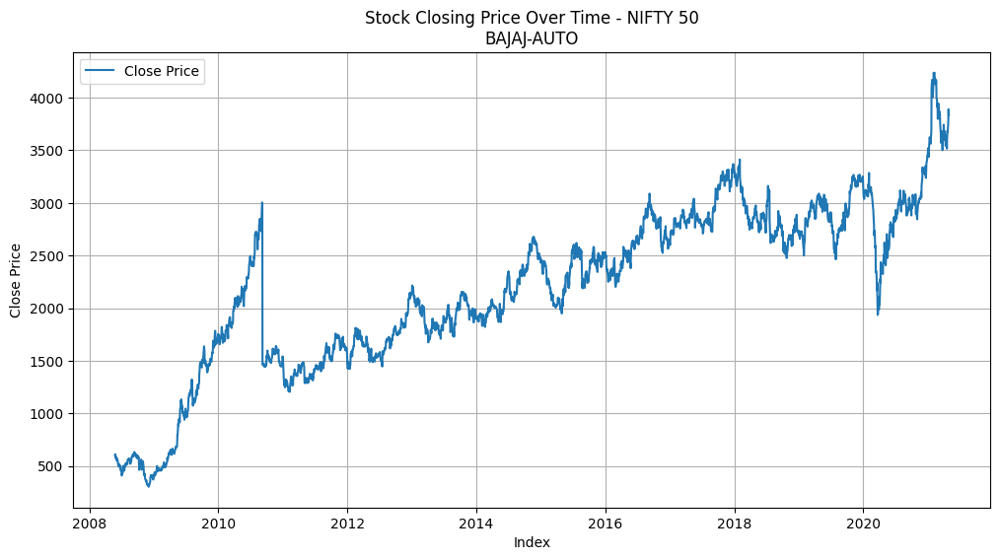

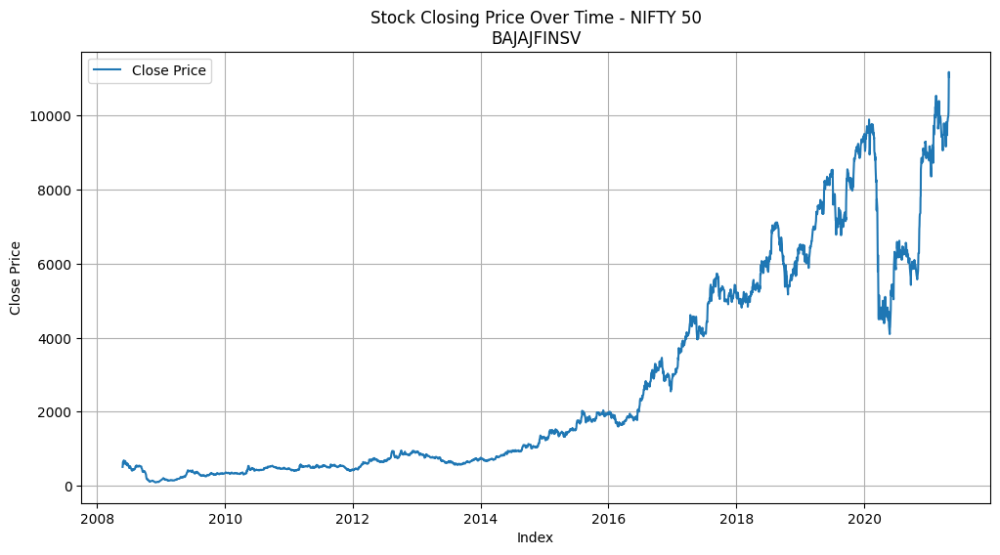

...

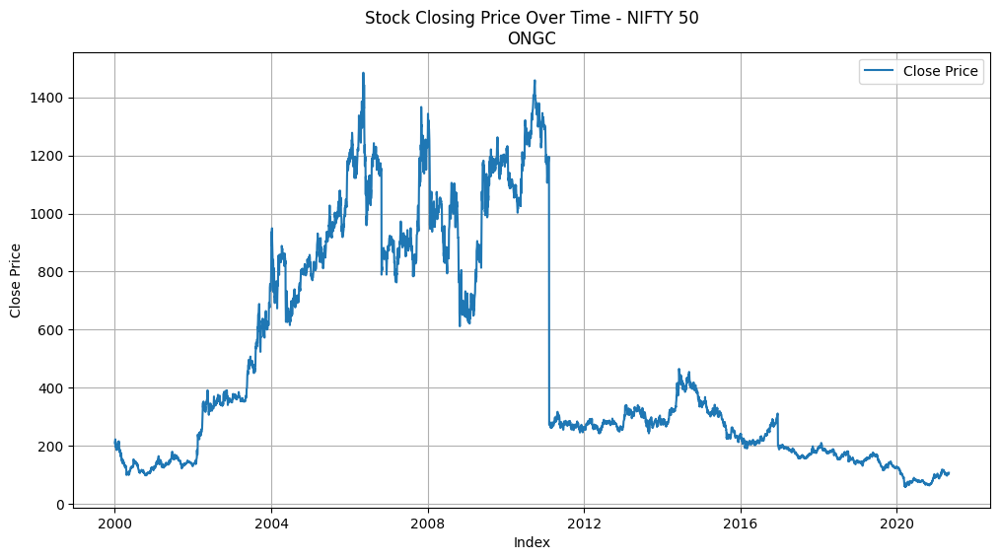

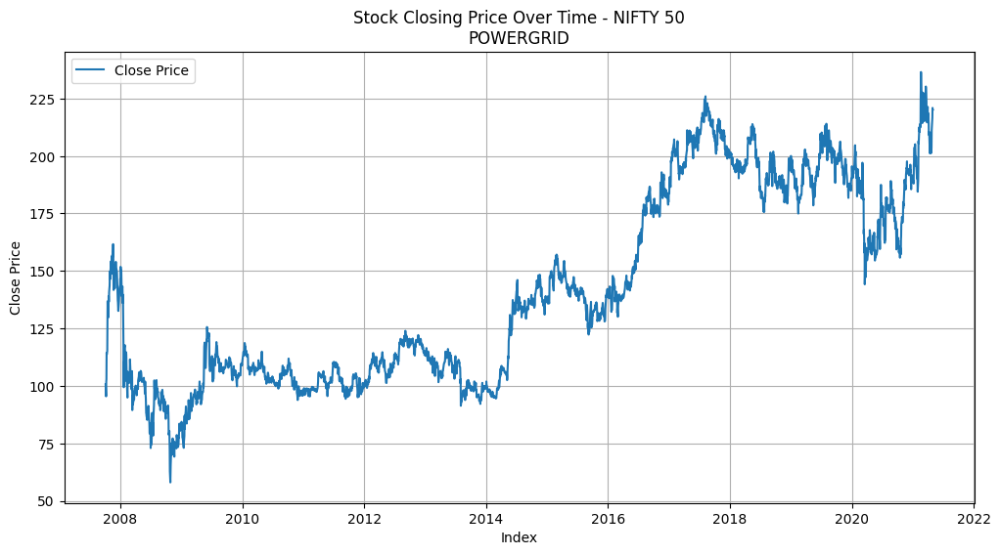

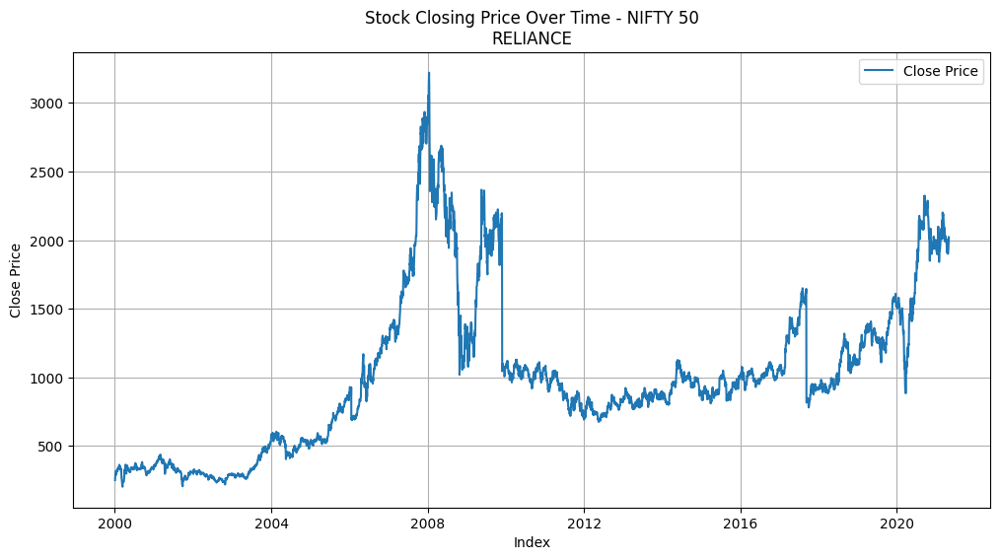

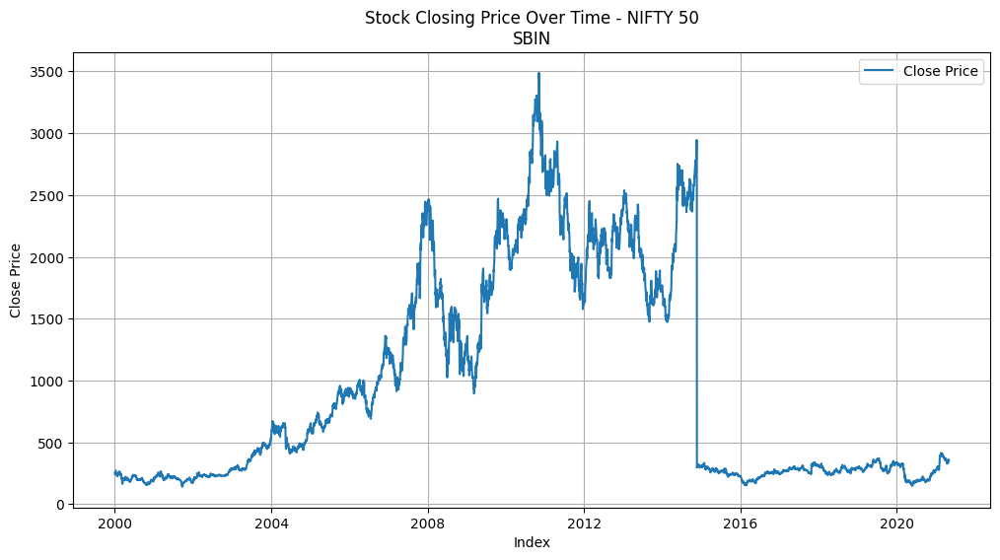

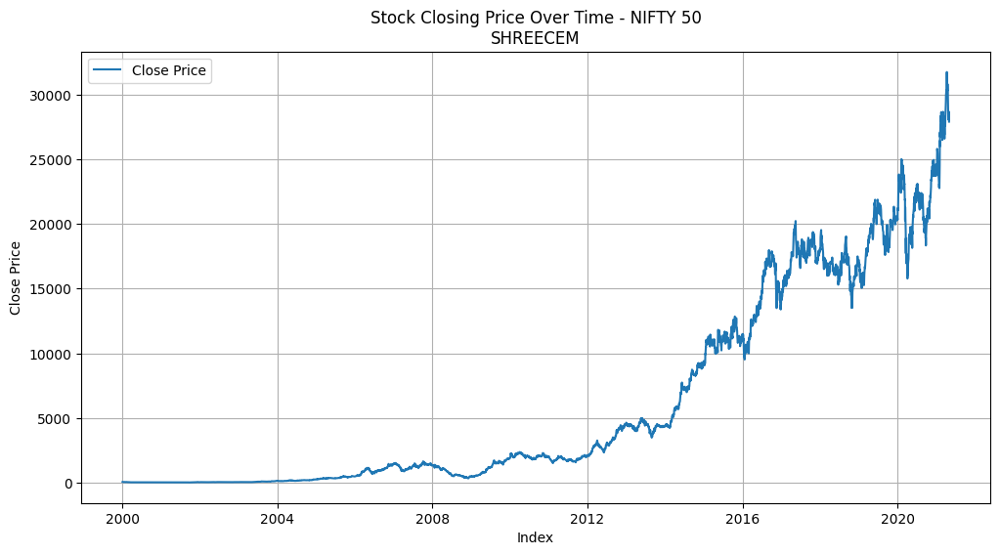

Skipping stock\stock_metadata.csv: 'Close' or 'Closing Price' column not found.


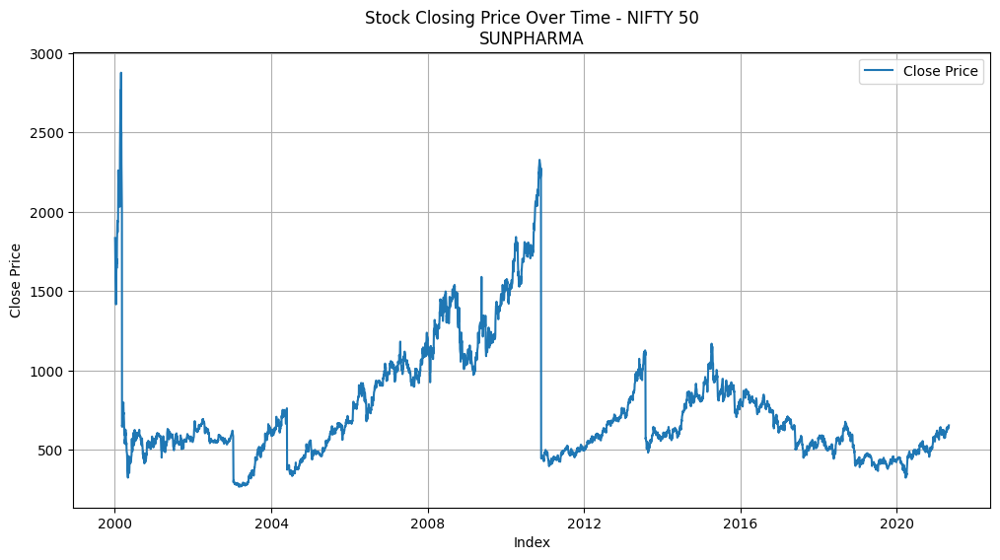

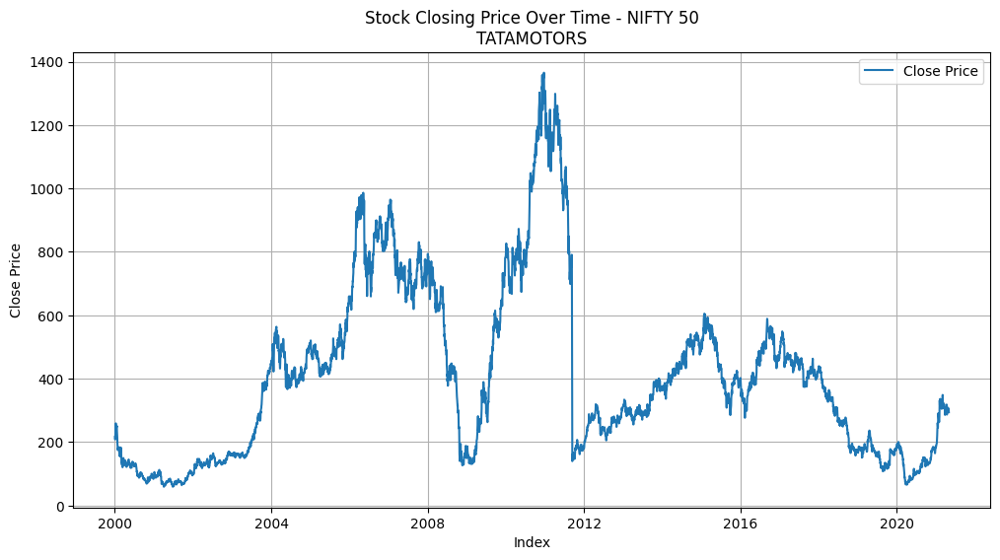

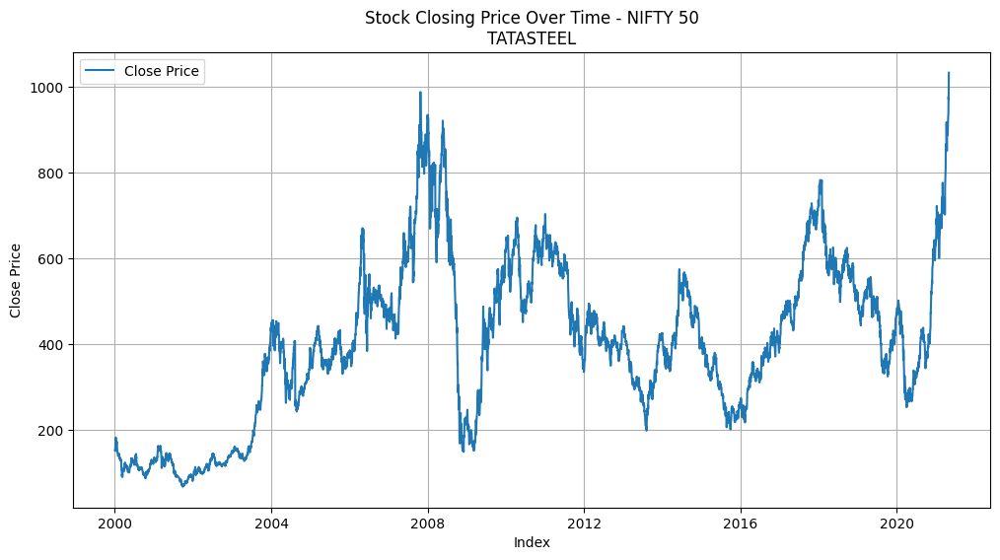

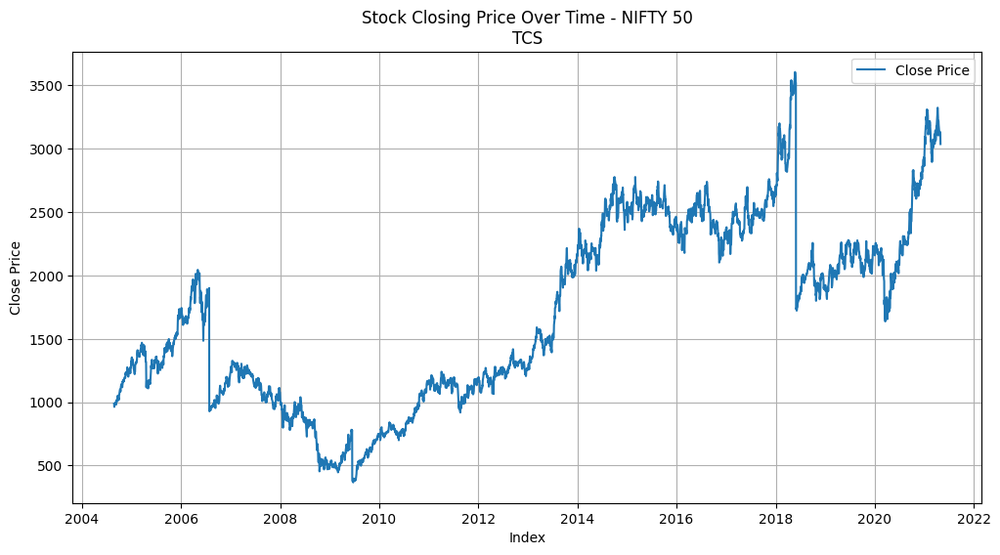

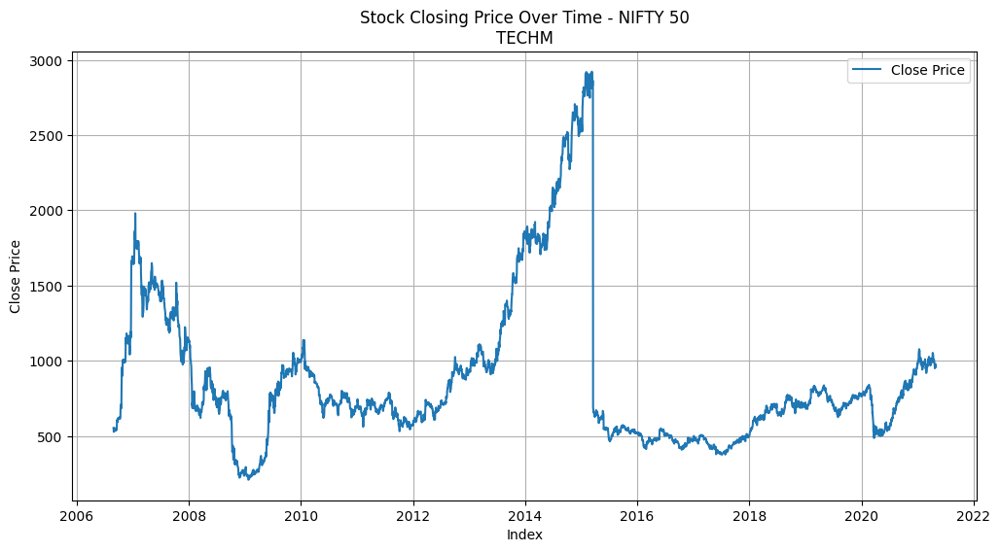

...

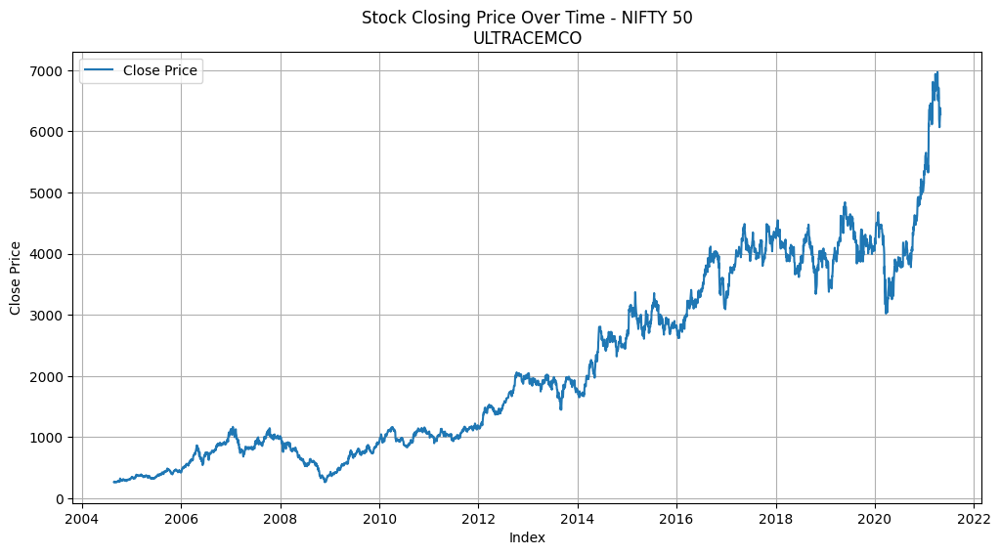

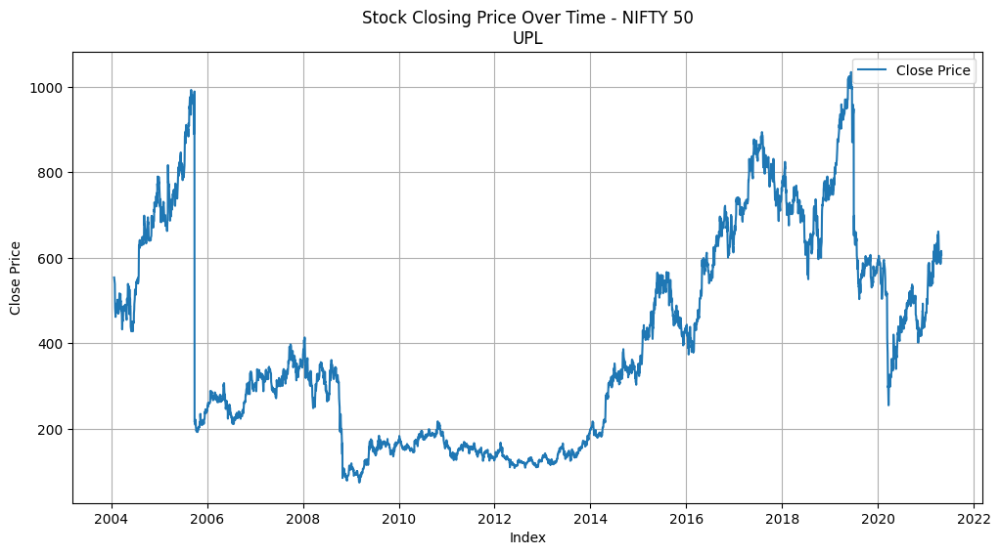

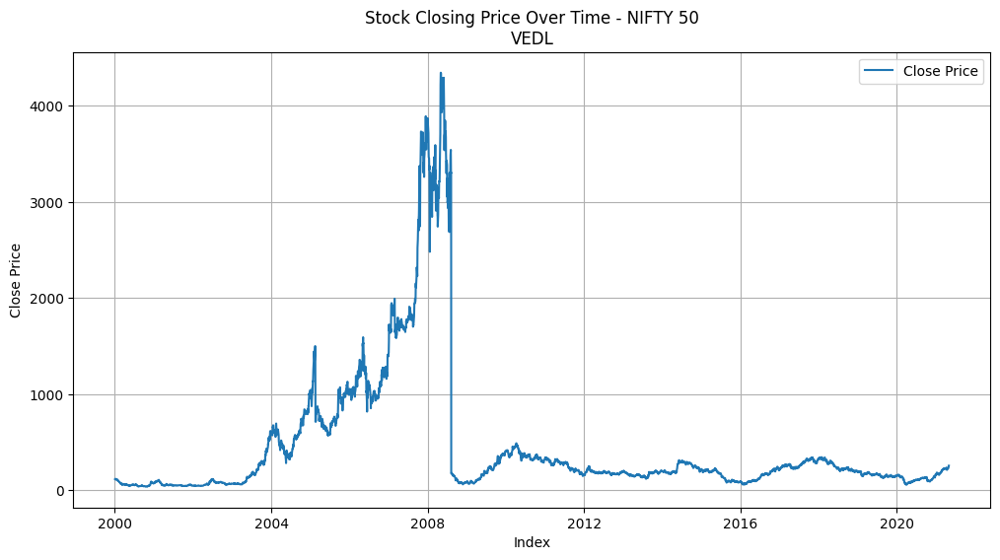

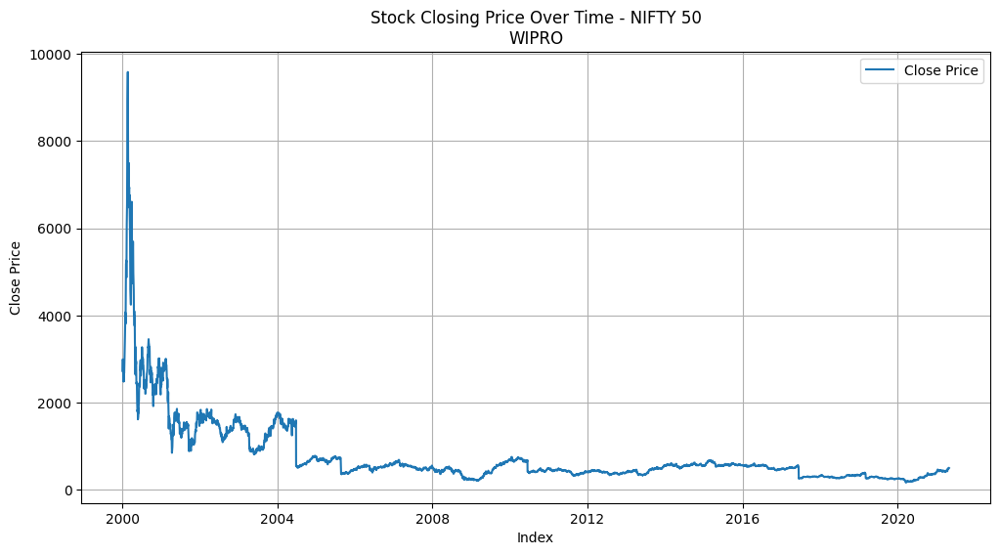

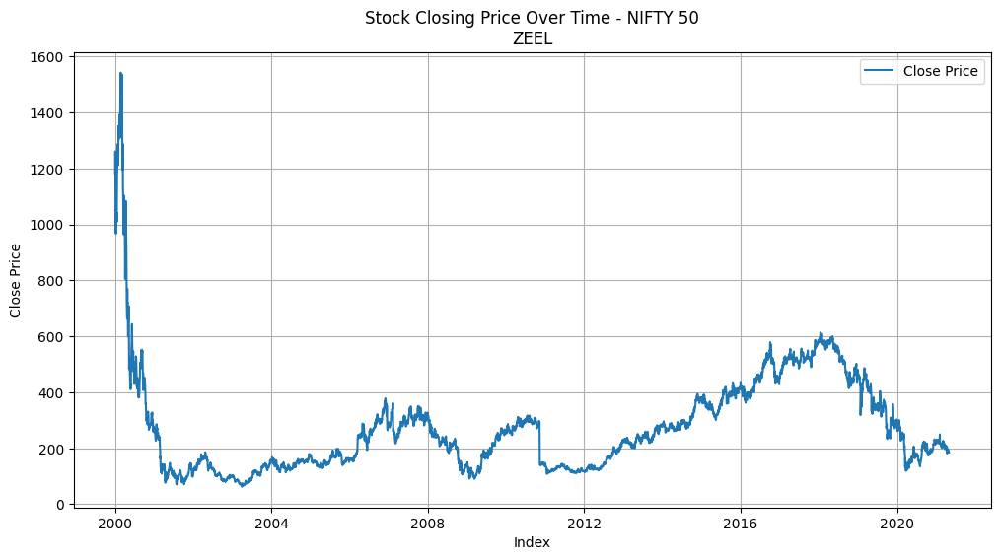

In [18]:
for idx, file_name in enumerate(files):
    file_path = os.path.join(data_path, file_name)  # Create the full file path
    dataset_name = f"Dataset {idx + 1}"  # Add a custom title for each dataset
    process_and_plot(file_path, "NIFTY 50") # Pass the full file path to the function

In [19]:
import pandas as pd
import plotly.express as px

In [20]:
df = pd.read_csv(file_path)


In [21]:
def process_and_plot(data_path, title_suffix, dataset_name): # Added dataset_name as a parameter
    try:
      df = pd.read_csv(data_path)

      # Check if 'Date' column exists before processing
      if 'Date' in df.columns:
          # Convert 'Date' column to datetime and set it as the index
          df['Date'] = pd.to_datetime(df['Date'])
          df.set_index('Date', inplace=True)

          # Sort data by date
          df.sort_index(inplace=True)

      # Check if 'Close' column exists, otherwise use a different column or skip
      if 'Close' in df.columns:
          plot_column = 'Close'  # Use 'Close' if it exists
      elif 'Closing Price' in df.columns:
          plot_column = 'Closing Price'  # Check for 'Closing Price' as alternative
      else:
          print(f"Skipping {data_path}: 'Close' or 'Closing Price' column not found.")
          return  # Skip plotting if neither column is found

      # Use df.index for x-axis data since 'Date' is the index
      # Add dataset_name to the title
      fig = px.line(df, x=df.index, y=plot_column,
                    title=f"Stock Closing Price Over Time ({dataset_name})",  # Modified title
                    labels={plot_column: 'Closing Price', 'x': 'Date'})

      # Add hover data to display values
      fig.update_traces(hovertemplate='Date: %{x}<br>Close: %{y}')

      # Customize layout for better interactivity
      fig.update_layout(
          hovermode='x unified',  # Show tooltip for x-axis alignment
          xaxis_title="Date",
          yaxis_title="Close Price",
          template="plotly_dark"  # Optional theme
      )

      # Show the plot
      fig.show()
    except Exception as e:
      print(f"Error processing {dataset_name}: {e}")

In [22]:
for idx, file_name in enumerate(files):
    file_path = os.path.join(data_path, file_name)
    dataset_name = f"Dataset {idx + 1}: {file_name}" # Includes filename in dataset_name
    process_and_plot(file_path, "NIFTY 50", dataset_name)  # Pass dataset_name

Skipping stock\stock_metadata.csv: 'Close' or 'Closing Price' column not found.


In [ ]:
import os
import pandas as pd
import plotly.express as px
import plotly.io as pio
from IPython.display import IFrame, display

In [ ]:
# def process_and_plot_subplots(data_paths, title_suffix):
#     num_plots = len(data_paths)
#     rows = (num_plots + 1) // 2  # Calculate number of rows, adjust as needed
#     cols = 2  # Number of columns, adjust as needed

#     fig = make_subplots(rows=rows, cols=cols,
#                         subplot_titles=[os.path.basename(path) for path in data_paths])  # Set subplot titles

#     for i, data_path in enumerate(data_paths):
#         df = pd.read_csv(data_path)

#         # Check if 'Date' column exists before processing
#         if 'Date' in df.columns:
#             # Convert 'Date' column to datetime and set it as the index
#             df['Date'] = pd.to_datetime(df['Date'])
#             df.set_index('Date', inplace=True)

#             # Sort data by date
#             df.sort_index(inplace=True)

#         # Check if 'Close' column exists, otherwise use a different column or skip
#         if 'Close' in df.columns:
#             plot_column = 'Close'  # Use 'Close' if it exists
#         elif 'Closing Price' in df.columns:
#             plot_column = 'Closing Price'  # Check for 'Closing Price' as alternative
#         else:
#             print(f"Skipping {data_path}: 'Close' or 'Closing Price' column not found.")
#             continue  # Skip to the next file

#         # Add trace to subplot:
#         fig = px.line(df, x=df.index, y=plot_column,
#                   title=f"Stock Closing Price Over Time ({dataset_name})",
#                   labels={plot_column: 'Closing Price', 'x': 'Date'})

#     fig.update_traces(hovertemplate='Date: %{x}<br>Close: %{y}')
#     fig.update_layout(hovermode='x unified', xaxis_title="Date",
#                       yaxis_title="Close Price", template="plotly_dark")

#     # Generate HTML and display:
#     html_string = pio.to_html(fig, full_html=False)  # full_html=False to avoid extra HTML
#     display(HTML(html_string))

In [ ]:
def process_and_plot(data_path, title_suffix, dataset_name):
    df = pd.read_csv(data_path)

    if 'Date' in df.columns:
        df['Date'] = pd.to_datetime(df['Date'])
        df.set_index('Date', inplace=True)

        df.sort_index(inplace=True)

    if 'Close' in df.columns:
        plot_column = 'Close'
    elif 'Closing Price' in df.columns:
        plot_column = 'Closing Price'
    else:
        print(f"Skipping {data_path}: 'Close' or 'Closing Price' column not found.")
        return

In [ ]:
for idx, file_name in enumerate(files):
    file_path = os.path.join(data_path, file_name)
    dataset_name = f"Dataset {idx + 1}: {file_name}" # Includes filename in dataset_name
    process_and_plot(file_path, "NIFTY 50", dataset_name)  # Pass dataset_name# Pass the full file path to the function

Skipping stock\stock_metadata.csv: 'Close' or 'Closing Price' column not found.


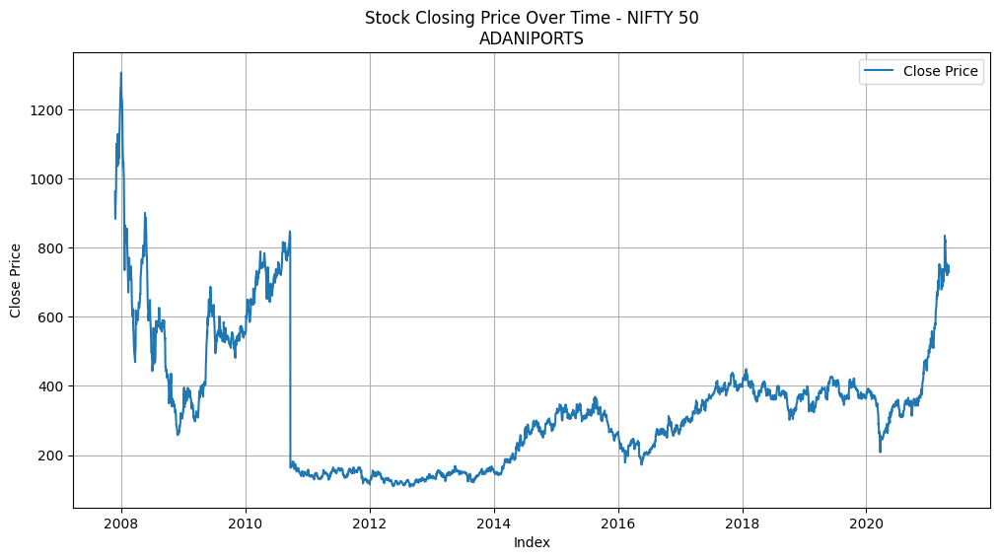

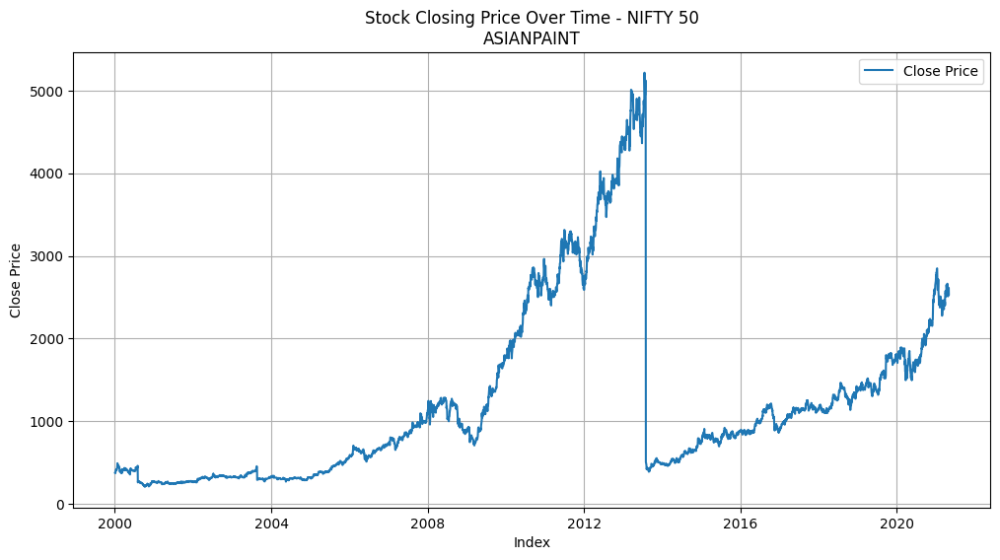

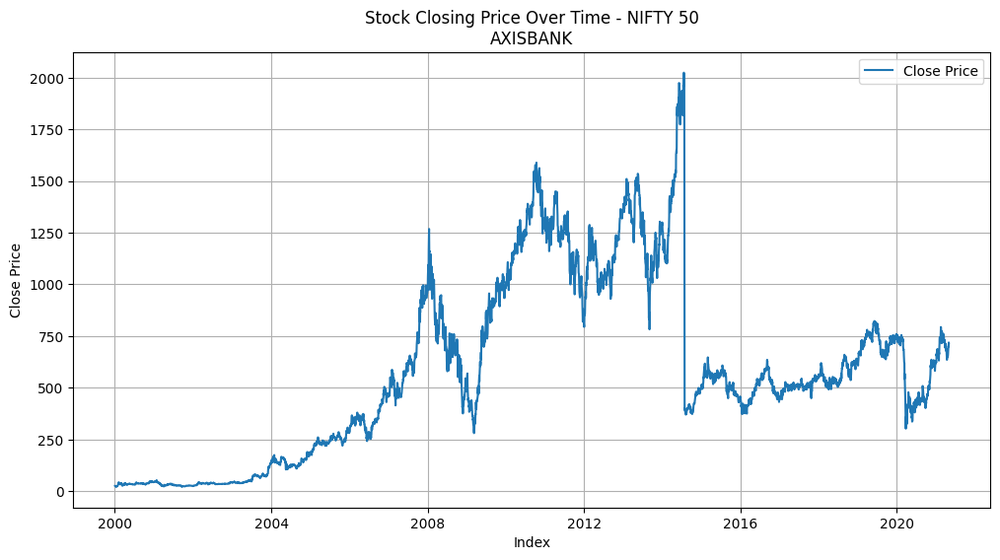

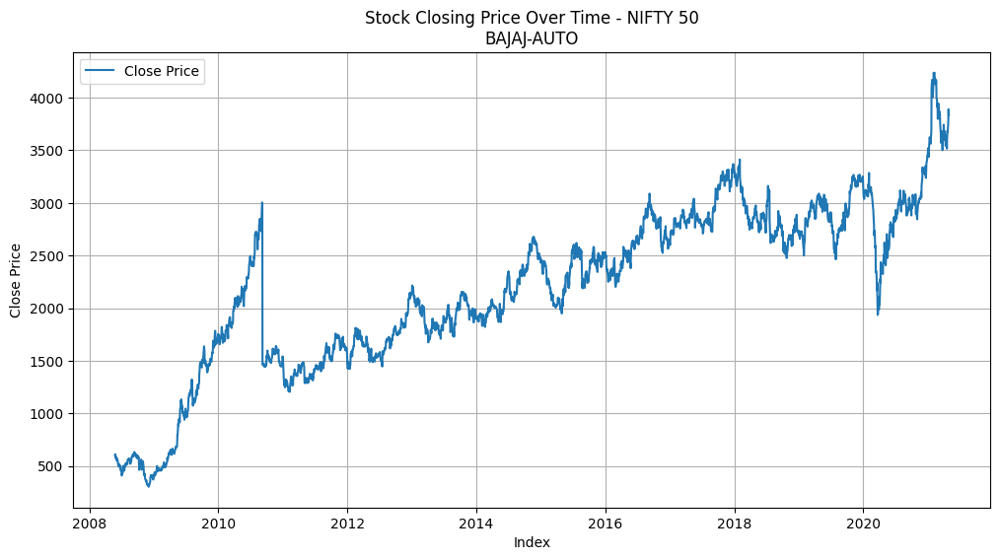

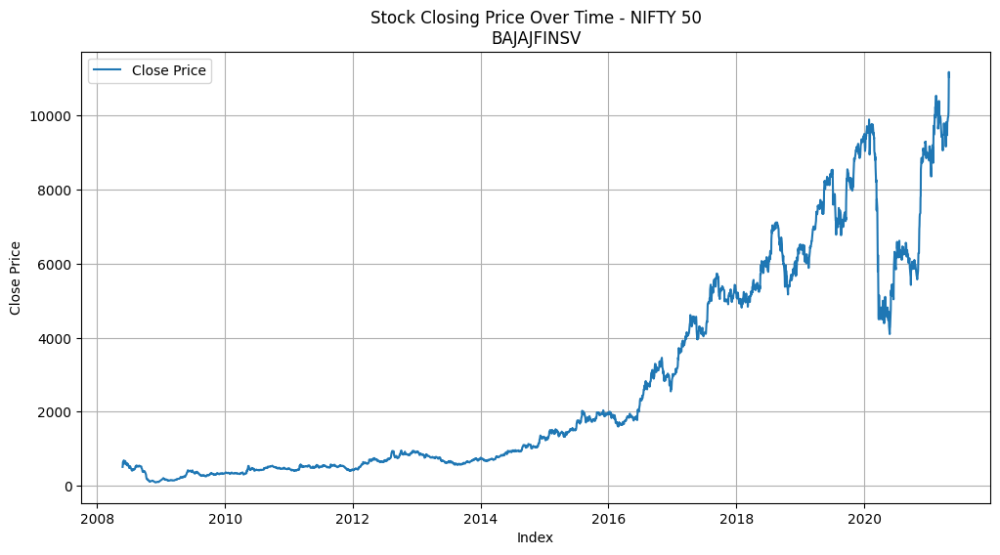

...

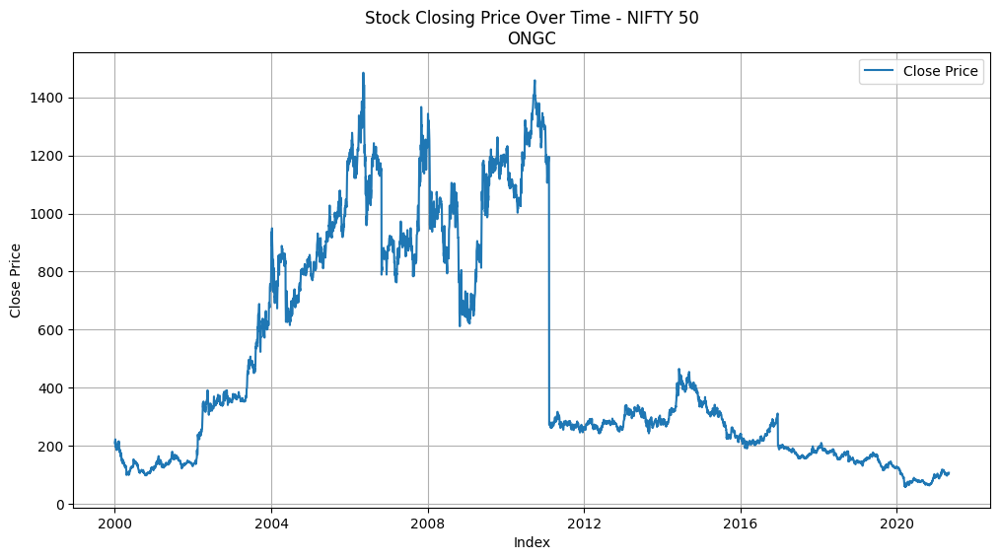

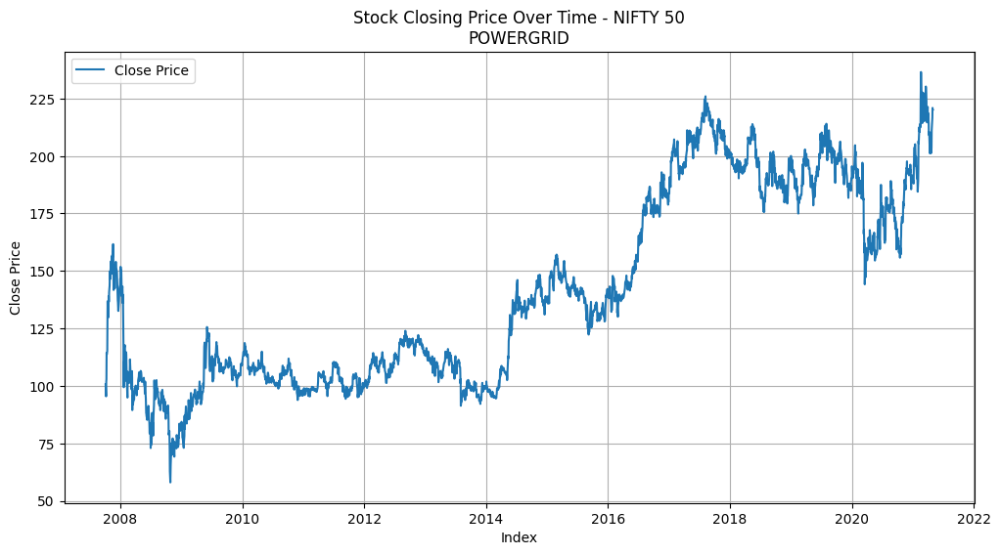

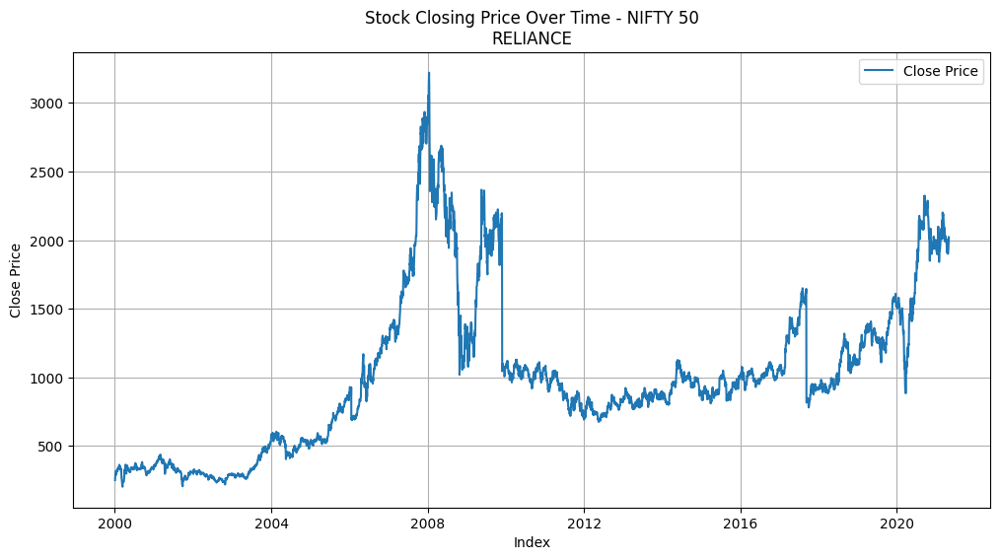

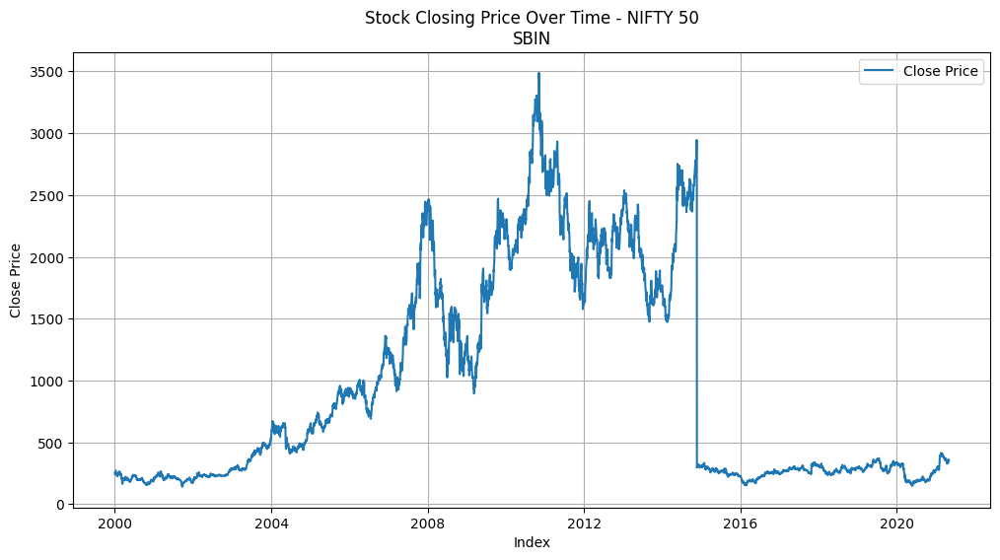

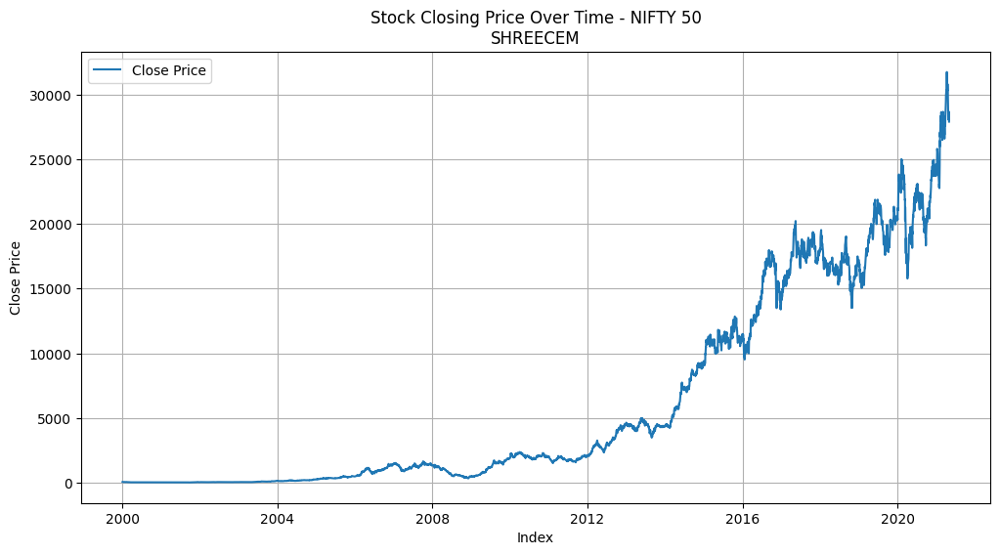

Skipping stock\stock_metadata.csv: 'Close' or 'Closing Price' column not found.


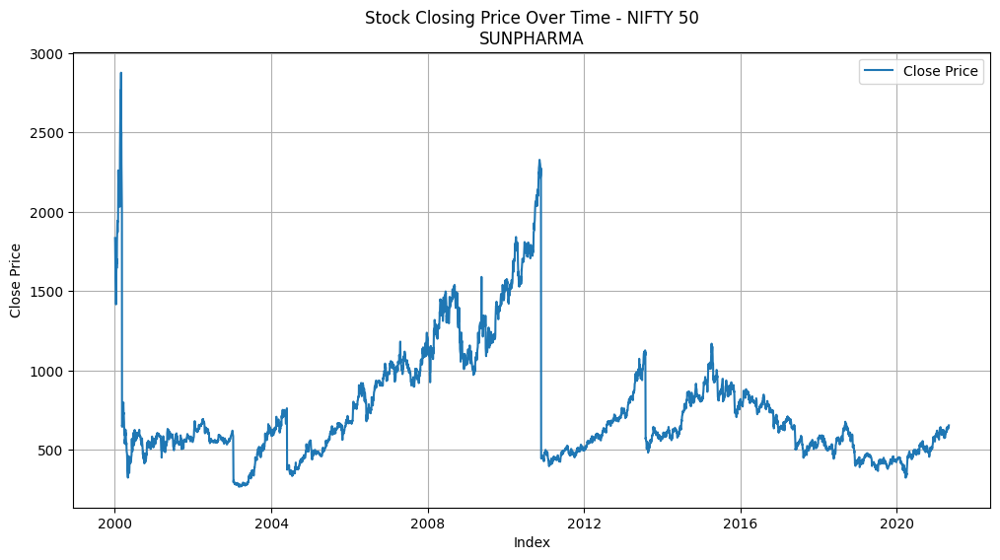

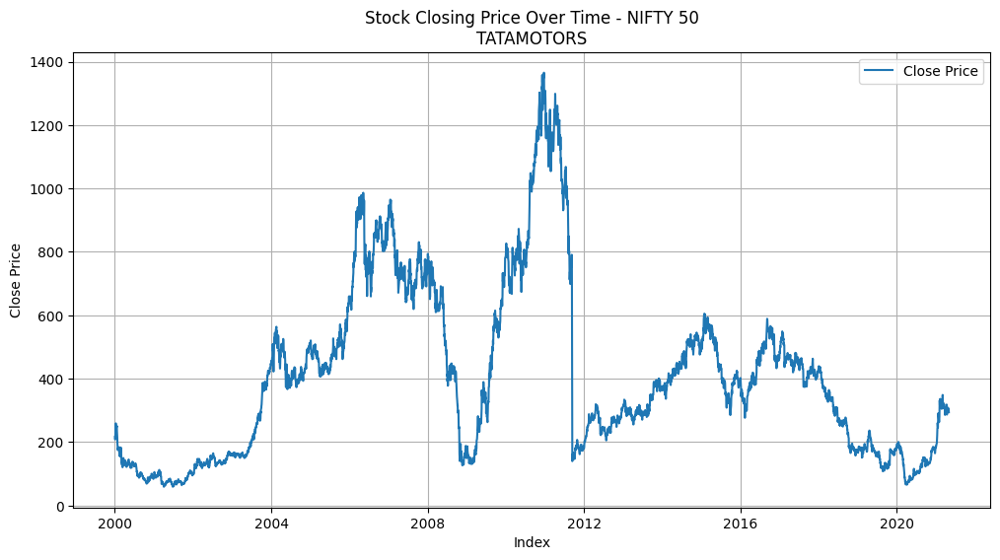

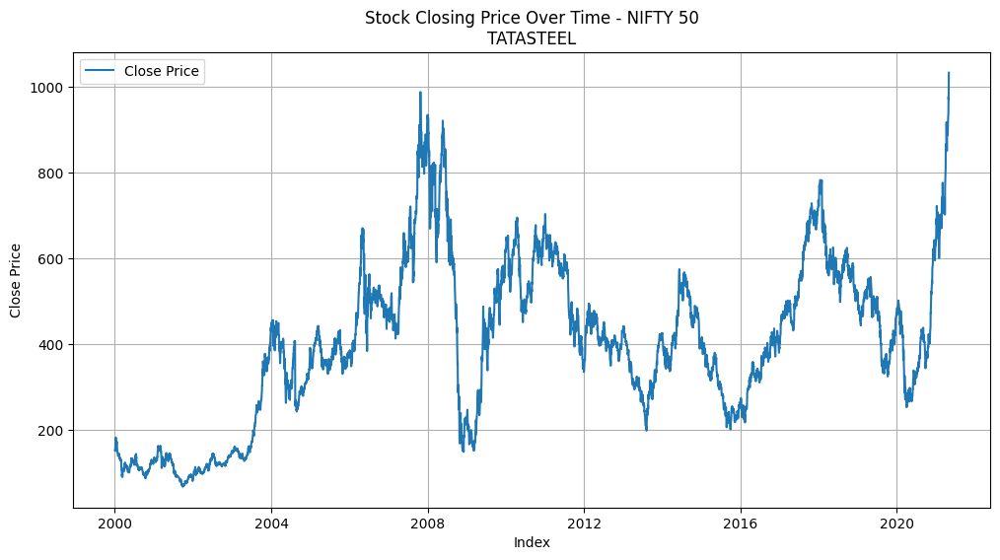

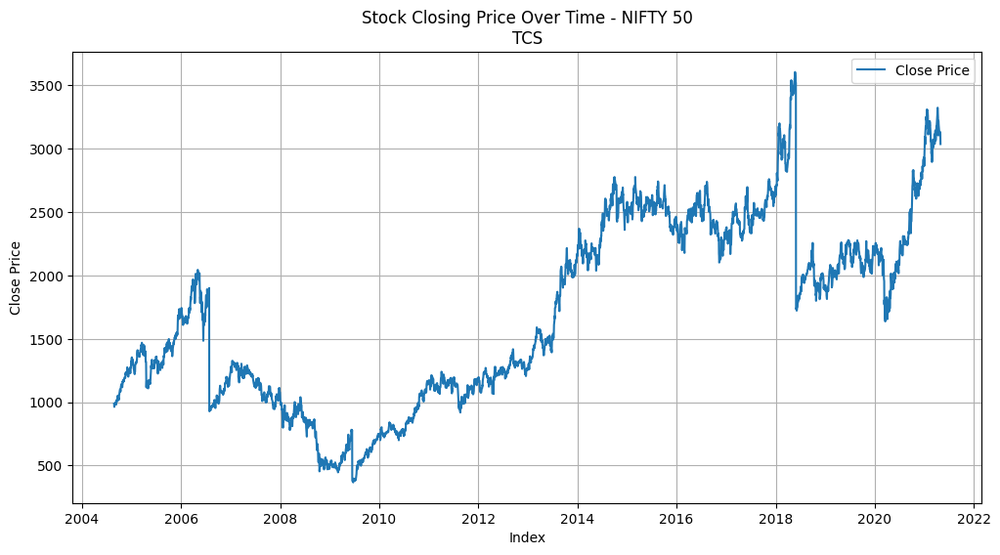

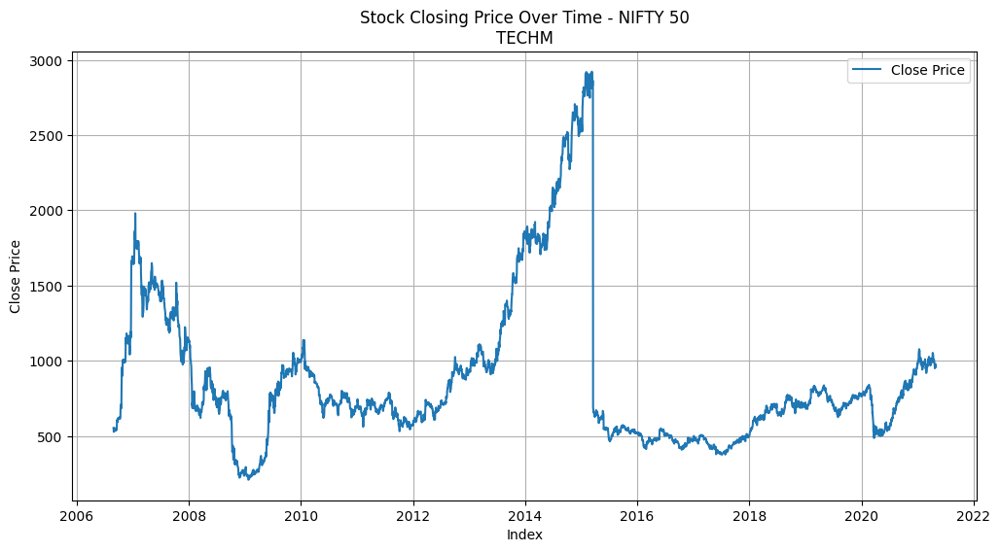

...

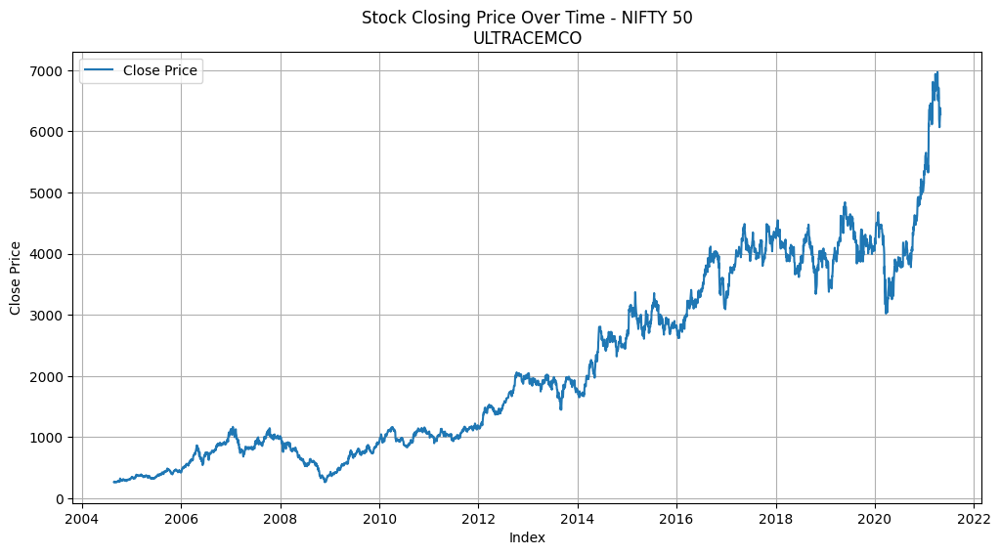

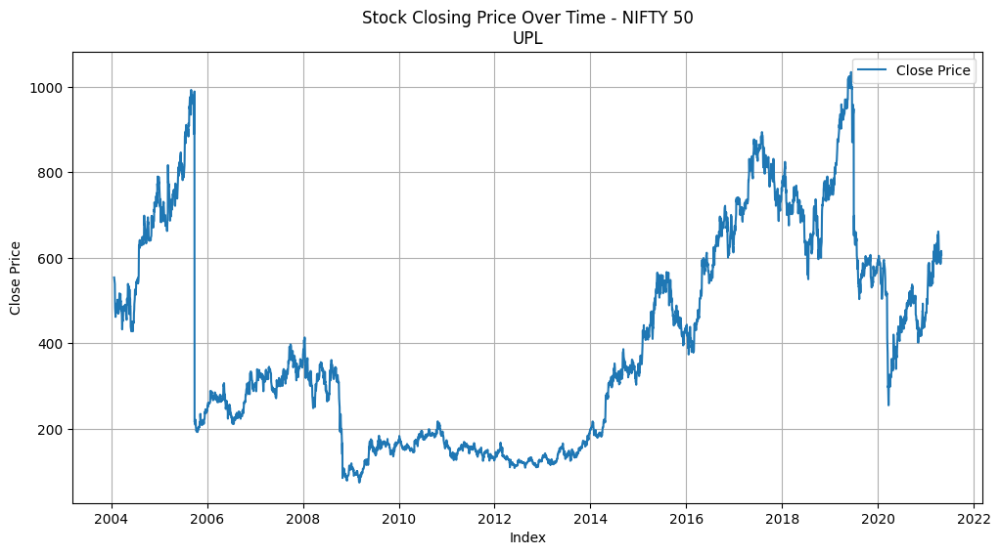

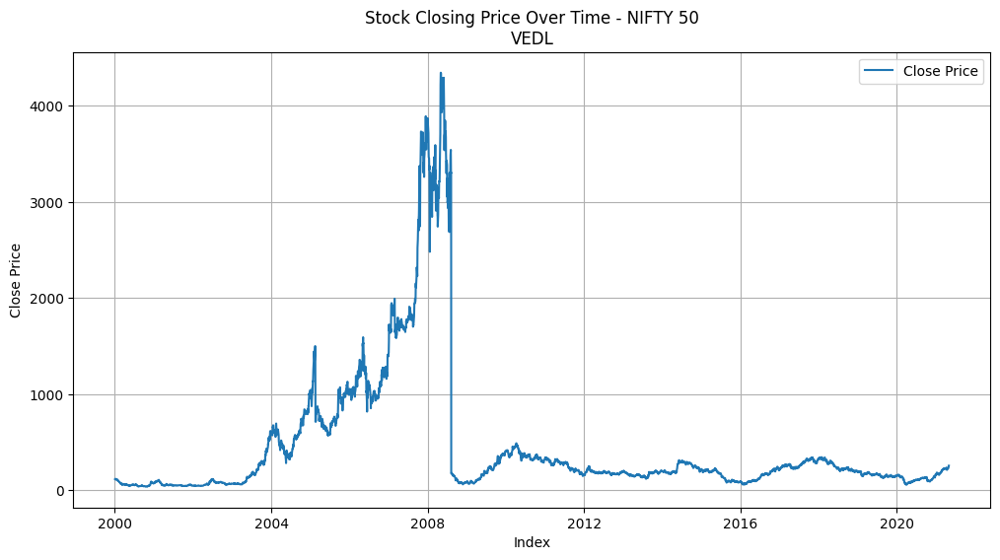

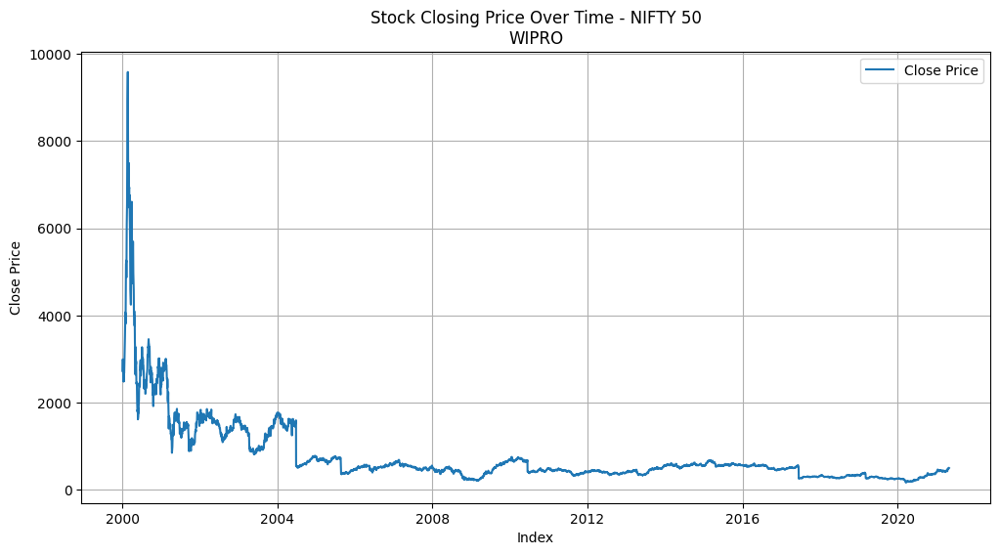

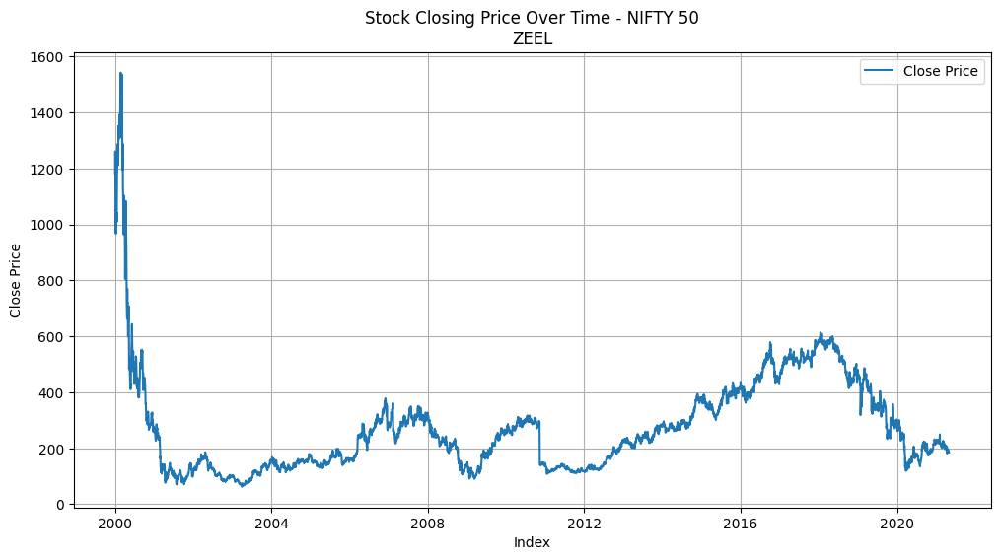

In [ ]:
# for idx, file_name in enumerate(files):
#     file_path = os.path.join(data_path, file_name)
#     dataset_name = f"Dataset {idx + 1}: {file_name}" # Includes filename in dataset_name
#     process_and_plot(file_path, "NIFTY 50")  # Pass dataset_name

NameError: name 'fig' is not defined